In [1]:
import pandas as pd

In [2]:
red_wine=pd.read_csv('winequality-red.csv', sep=';')
white_wine=pd.read_csv('winequality-white.csv', sep=';')

In [3]:
red_wine.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [47]:
len(red_wine)

1599

In [48]:
white_wine.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6


In [4]:
red_wine['wine_type_code'] = 0
white_wine['wine_type_code'] = 1
red_wine['wine_type']='red'
white_wine['wine_type']= 'white'

In [50]:
red_wine['quality_label'] = red_wine['quality'].apply(lambda value: 'low'
if value <= 5 else 'medium'
if value <= 7 else 'high')

red_wine['quality_label'] = pd.Categorical(red_wine['quality_label'],
categories=['low', 'medium', 'high'])

white_wine['quality_label'] = white_wine['quality'].apply(lambda value: 'low'
if value <= 5 else 'medium'
if value <= 7 else 'high')

white_wine['quality_label'] = pd.Categorical(white_wine['quality_label'],
categories=['low', 'medium', 'high'])

In [4]:
wines = pd.concat([red_wine, white_wine])
wines = wines.sample(frac=1, random_state=42).reset_index(drop=True)

In [5]:
(wines.groupby('quality')).count()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,wine_type_code,wine_type
quality,,,,,,,,,,,,,
3,30,30,30,30,30,30,30,30,30,30,30,30,30
4,216,216,216,216,216,216,216,216,216,216,216,216,216
5,2138,2138,2138,2138,2138,2138,2138,2138,2138,2138,2138,2138,2138
6,2836,2836,2836,2836,2836,2836,2836,2836,2836,2836,2836,2836,2836
7,1079,1079,1079,1079,1079,1079,1079,1079,1079,1079,1079,1079,1079
8,193,193,193,193,193,193,193,193,193,193,193,193,193
9,5,5,5,5,5,5,5,5,5,5,5,5,5


In [52]:
wines.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,wine_type_code,wine_type,quality_label
0,7.0,0.17,0.74,12.8,0.045,24.0,126.0,0.99420,3.26,0.38,12.2,8,1,white,high
1,7.7,0.64,0.21,2.2,0.077,32.0,133.0,0.99560,3.27,0.45,9.9,5,0,red,low
2,6.8,0.39,0.34,7.4,0.020,38.0,133.0,0.99212,3.18,0.44,12.0,7,1,white,medium
3,6.3,0.28,0.47,11.2,0.040,61.0,183.0,0.99592,3.12,0.51,9.5,6,1,white,medium
4,7.4,0.35,0.20,13.9,0.054,63.0,229.0,0.99888,3.11,0.50,8.9,6,1,white,medium


In [53]:
len(wines)

6497

In [54]:
abs((white_wine.mean()-red_wine.mean())/white_wine.mean())

fixed acidity           0.213697
volatile acidity        0.896990
citric acid             0.189161
residual sugar          0.602779
chlorides               0.910903
free sulfur dioxide     0.550388
total sulfur dioxide    0.664155
density                 0.002736
pH                      0.038531
sulphates               0.343581
alcohol                 0.008682
quality                 0.041152
wine_type_code          1.000000
dtype: float64

In [55]:
red_wine.mean()

fixed acidity            8.319637
volatile acidity         0.527821
citric acid              0.270976
residual sugar           2.538806
chlorides                0.087467
free sulfur dioxide     15.874922
total sulfur dioxide    46.467792
density                  0.996747
pH                       3.311113
sulphates                0.658149
alcohol                 10.422983
quality                  5.636023
wine_type_code           0.000000
dtype: float64

In [56]:
len(red_wine[red_wine['chlorides']<0.05])

50

In [57]:
len(white_wine[white_wine['chlorides']>0.05])

1163

In [58]:
import numpy as np

In [59]:
min=10000
ideal_c=0
ideal_v=0
for c in np.linspace(0, 0.3, num=100):
    for v in np.linspace(0,1,num=100):
        k=len(red_wine[(red_wine['chlorides']<c) & (red_wine['volatile acidity']<v)])+len(white_wine[white_wine['chlorides']>c])+len(red_wine[red_wine['volatile acidity']<v])+len(white_wine[white_wine['volatile acidity']>v])
        if k<min:
            min=k
            ideal_c=c
            ideal_v=v
print(ideal_c, ideal_v, k)

0.0696969696969697 0.4545454545454546 3132


In [60]:
import matplotlib.pyplot as plt

In [2]:
#plt.plot(red_wine['volatile acidity'], red_wine['free sulfur dioxide'], 'b.')
#plt.plot(white_wine['volatile acidity'], white_wine['free sulfur dioxide'], 'g.')
#plt.show

In [62]:

import seaborn as sns


In [4]:
#g = pd.plotting.scatter_matrix(wines[0:30], figsize=(10,10), marker = 'o', hist_kwds = {'bins': 10}, s = 60, alpha = 0.8)


In [64]:
wines[0:300]

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,wine_type_code,wine_type,quality_label
0,7.0,0.17,0.74,12.8,0.045,24.0,126.0,0.99420,3.26,0.38,12.2,8,1,white,high
1,7.7,0.64,0.21,2.2,0.077,32.0,133.0,0.99560,3.27,0.45,9.9,5,0,red,low
2,6.8,0.39,0.34,7.4,0.020,38.0,133.0,0.99212,3.18,0.44,12.0,7,1,white,medium
3,6.3,0.28,0.47,11.2,0.040,61.0,183.0,0.99592,3.12,0.51,9.5,6,1,white,medium
4,7.4,0.35,0.20,13.9,0.054,63.0,229.0,0.99888,3.11,0.50,8.9,6,1,white,medium
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,8.5,0.19,0.48,1.1,0.026,23.0,58.0,0.99184,2.90,0.50,10.5,6,1,white,medium
296,7.0,0.27,0.48,6.1,0.042,60.0,184.0,0.99566,3.20,0.50,9.4,6,1,white,medium
297,6.4,0.17,0.32,2.4,0.048,41.0,200.0,0.99380,3.50,0.50,9.7,6,1,white,medium
298,6.6,0.24,0.28,6.7,0.032,26.0,91.0,0.99172,3.13,0.32,12.3,6,1,white,medium


In [65]:
wines['wine_type'] = pd.Categorical(wines['wine_type_code'],
categories=['red', 'white'])

In [6]:
#sns.pairplot(wines[0:300], hue='wine_type_code', size=1.5)

In [67]:
from sklearn.model_selection import train_test_split
Xtrain, Xtest, ytrain, ytest = train_test_split(wines.iloc[:,0:12], wines.iloc[:,12], random_state=1)

In [68]:
wines.iloc[:,12]

0       1
1       0
2       1
3       1
4       1
       ..
6492    1
6493    1
6494    1
6495    1
6496    0
Name: wine_type_code, Length: 6497, dtype: int64

In [69]:
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
X_train=sc.fit_transform(Xtrain)
X_test=sc.fit_transform(Xtest)

In [70]:
from sklearn.naive_bayes import GaussianNB
model = GaussianNB()
model.fit(X_train, ytrain)#underscore means rescaled
y_model = model.predict(X_test)
#result: approximately 96-98 %

In [71]:
from sklearn.metrics import accuracy_score 
accuracy_score(ytest, y_model)

0.9772307692307692

Text(91.68, 0.5, 'true value')

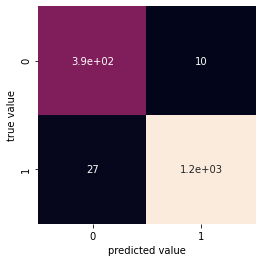

In [72]:
from sklearn.metrics import confusion_matrix 
mat = confusion_matrix(ytest, y_model)
sns.heatmap(mat, square=True, annot=True, cbar=False)
plt.xlabel('predicted value')
plt.ylabel('true value')


In [73]:
from sklearn.neighbors import KNeighborsClassifier 
model = KNeighborsClassifier(n_neighbors=4)
model.fit(X_train, ytrain)#underscore == rescaled
y_model = model.predict(X_test)
#result: 92-94%

In [74]:
from sklearn.model_selection import cross_val_score 
X=wines.iloc[:,0:12]#stays fixed
y= wines.iloc[:,12]#12-> string, 14-> 0 or 1
cross_val_score(model, X, y, cv=5)

array([0.94153846, 0.93307692, 0.94457275, 0.93225558, 0.9361047 ])

In [75]:
from sklearn.model_selection import LeaveOneOut
scores = cross_val_score(model, X, y, cv=LeaveOneOut()) 

In [76]:
scores.mean()

0.9387409573649377

In [77]:
from sklearn.linear_model import LogisticRegression
classifier=LogisticRegression()
classifier.fit(X_train, ytrain)
#Logistic regression gives an accuracy of over 99%, mislabeling 11 wines out of 1625!!

LogisticRegression()

In [78]:
y_pred=classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), (np.array(ytest)).reshape(len(np.array(ytest)),1)),1))

[[1 1]
 [1 1]
 [0 0]
 ...
 [1 1]
 [0 0]
 [1 1]]


In [79]:
confusion_matrix(y_pred, ytest)


array([[ 400,    8],
       [   3, 1214]])

In [80]:
accuracy_score(y_pred, ytest)

0.9932307692307693

In [81]:
from sklearn.svm import SVC
classifier=SVC(kernel='rbf')#kernel=linear or rbf
classifier.fit(X_train, ytrain)
#support vector machine regression
#linear kernel: same as logistic regression
#rbf kernel: even better, 99,7% accuracy

SVC()

In [82]:
from sklearn.tree import DecisionTreeClassifier
classifier=DecisionTreeClassifier(criterion='entropy')
classifier.fit(X_train, ytrain)
#98,3% accuracy

DecisionTreeClassifier(criterion='entropy')

In [83]:
from sklearn.ensemble import RandomForestClassifier
classifier=RandomForestClassifier(n_estimators=100, criterion='entropy')
classifier.fit(X_train,ytrain)
#accuracy: 99,6%

RandomForestClassifier(criterion='entropy')

In [84]:
wines.head(10)

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,wine_type_code,wine_type,quality_label
0,7.0,0.17,0.74,12.8,0.045,24.0,126.0,0.99420,3.26,0.38,12.2,8,1,NaN,high
1,7.7,0.64,0.21,2.2,0.077,32.0,133.0,0.99560,3.27,0.45,9.9,5,0,NaN,low
2,6.8,0.39,0.34,7.4,0.020,38.0,133.0,0.99212,3.18,0.44,12.0,7,1,NaN,medium
3,6.3,0.28,0.47,11.2,0.040,61.0,183.0,0.99592,3.12,0.51,9.5,6,1,NaN,medium
4,7.4,0.35,0.20,13.9,0.054,63.0,229.0,0.99888,3.11,0.50,8.9,6,1,NaN,medium
5,7.2,0.53,0.14,2.1,0.064,15.0,29.0,0.99323,3.35,0.61,12.1,6,0,NaN,medium
6,7.5,0.27,0.31,17.7,0.051,33.0,173.0,0.99900,3.09,0.64,10.2,5,1,NaN,low
7,6.8,0.11,0.27,8.6,0.044,45.0,104.0,0.99454,3.20,0.37,9.9,6,1,NaN,medium
8,9.0,0.44,0.49,2.4,0.078,26.0,121.0,0.99780,3.23,0.58,9.2,5,0,NaN,low
9,7.1,0.23,0.30,2.6,0.034,62.0,148.0,0.99121,3.03,0.56,11.3,7,1,NaN,medium


In [85]:
wines.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6497 entries, 0 to 6496
Data columns (total 15 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   fixed acidity         6497 non-null   float64 
 1   volatile acidity      6497 non-null   float64 
 2   citric acid           6497 non-null   float64 
 3   residual sugar        6497 non-null   float64 
 4   chlorides             6497 non-null   float64 
 5   free sulfur dioxide   6497 non-null   float64 
 6   total sulfur dioxide  6497 non-null   float64 
 7   density               6497 non-null   float64 
 8   pH                    6497 non-null   float64 
 9   sulphates             6497 non-null   float64 
 10  alcohol               6497 non-null   float64 
 11  quality               6497 non-null   int64   
 12  wine_type_code        6497 non-null   int64   
 13  wine_type             0 non-null      category
 14  quality_label         6497 non-null   category
dtypes: c

In [86]:
wines.shape

(6497, 15)

In [87]:
np.sum(pd.isna(wines))

fixed acidity              0
volatile acidity           0
citric acid                0
residual sugar             0
chlorides                  0
free sulfur dioxide        0
total sulfur dioxide       0
density                    0
pH                         0
sulphates                  0
alcohol                    0
quality                    0
wine_type_code             0
wine_type               6497
quality_label              0
dtype: int64

In [88]:
q1r=[]
q2r=[]
q3r=[]

for i in range(12):
    q1r.append(np.percentile(red_wine.iloc[:,i], 25))
    q2r.append(np.median(red_wine.iloc[:,i]))
    q3r.append(np.percentile(red_wine.iloc[:,i], 75))
print(q1r,q2r,q3r)

[7.1, 0.39, 0.09, 1.9, 0.07, 7.0, 22.0, 0.9956, 3.21, 0.55, 9.5, 5.0] [7.9, 0.52, 0.26, 2.2, 0.079, 14.0, 38.0, 0.99675, 3.31, 0.62, 10.2, 6.0] [9.2, 0.64, 0.42, 2.6, 0.09, 21.0, 62.0, 0.9978349999999999, 3.4, 0.73, 11.1, 6.0]


In [89]:
q1w=[]
q2w=[]
q3w=[]

for i in range(12):
    q1w.append(np.percentile(white_wine.iloc[:,i], 25))
    q2w.append(np.median(white_wine.iloc[:,i]))
    q3w.append(np.percentile(white_wine.iloc[:,i], 75))
print(q1w,q2w,q3w)

[6.3, 0.21, 0.27, 1.7, 0.036000000000000004, 23.0, 108.0, 0.9917225000000001, 3.09, 0.41, 9.5, 5.0] [6.8, 0.26, 0.32, 5.2, 0.043, 34.0, 134.0, 0.99374, 3.18, 0.47, 10.4, 6.0] [7.3, 0.32, 0.39, 9.9, 0.05, 46.0, 167.0, 0.9961, 3.28, 0.55, 11.4, 6.0]


In [90]:
redvalues=np.vstack((red_wine.iloc[:,0:12].count(), red_wine.iloc[:,0:12].mean(), red_wine.iloc[:,0:12].std(), red_wine.iloc[:,0:12].min(),q1r,q2r,q3r, red_wine.iloc[:,0:12].max()))
redvalues=redvalues.round(decimals=2)
redvalues[0,:]=redvalues[0,:].round(decimals=0)
redvalues

array([[1.599e+03, 1.599e+03, 1.599e+03, 1.599e+03, 1.599e+03, 1.599e+03,
        1.599e+03, 1.599e+03, 1.599e+03, 1.599e+03, 1.599e+03, 1.599e+03],
       [8.320e+00, 5.300e-01, 2.700e-01, 2.540e+00, 9.000e-02, 1.587e+01,
        4.647e+01, 1.000e+00, 3.310e+00, 6.600e-01, 1.042e+01, 5.640e+00],
       [1.740e+00, 1.800e-01, 1.900e-01, 1.410e+00, 5.000e-02, 1.046e+01,
        3.290e+01, 0.000e+00, 1.500e-01, 1.700e-01, 1.070e+00, 8.100e-01],
       [4.600e+00, 1.200e-01, 0.000e+00, 9.000e-01, 1.000e-02, 1.000e+00,
        6.000e+00, 9.900e-01, 2.740e+00, 3.300e-01, 8.400e+00, 3.000e+00],
       [7.100e+00, 3.900e-01, 9.000e-02, 1.900e+00, 7.000e-02, 7.000e+00,
        2.200e+01, 1.000e+00, 3.210e+00, 5.500e-01, 9.500e+00, 5.000e+00],
       [7.900e+00, 5.200e-01, 2.600e-01, 2.200e+00, 8.000e-02, 1.400e+01,
        3.800e+01, 1.000e+00, 3.310e+00, 6.200e-01, 1.020e+01, 6.000e+00],
       [9.200e+00, 6.400e-01, 4.200e-01, 2.600e+00, 9.000e-02, 2.100e+01,
        6.200e+01, 1.000e+00, 3.

In [91]:
whitevalues=np.vstack((white_wine.iloc[:,0:12].count(), white_wine.iloc[:,0:12].mean(), white_wine.iloc[:,0:12].std(), white_wine.iloc[:,0:12].min(),q1w,q2w,q3w, white_wine.iloc[:,0:12].max()))
whitevalues=whitevalues.round(decimals=2)

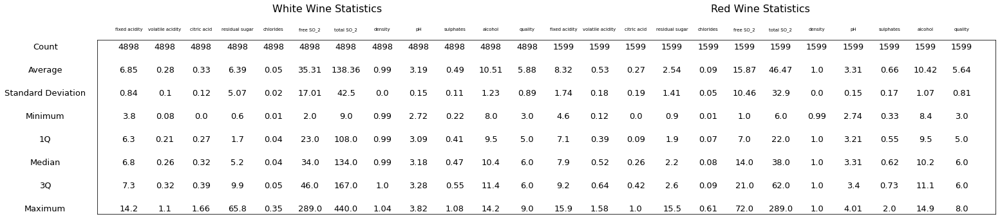

In [92]:
#%matplotlibe inline
#import matplotlib.pyplot as plt
cols=np.array(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free SO_2', 'total SO_2', 'density', 'pH', 'sulphates', 'alcohol', 'quality','fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free SO_2', 'total SO_2', 'density', 'pH', 'sulphates', 'alcohol', 'quality'])
labels=np.array(['Count', 'Average', 'Standard Deviation', 'Minimum', '1Q', 'Median', '3Q', 'Maximum'])
fig = plt.figure(figsize=(25,5)) 
ax=fig.add_subplot(1,1,1)
for j in range(8):
    for i in range(12):
               if j==0:
                    fig.text(0.152+i/32, 0.84-0.1*j, int(whitevalues[j,i]),fontsize=13, ha='center')
                    fig.text(0.527+i/32, 0.84-0.1*j, int(redvalues[j,i]),fontsize=13, ha='center') 
               else:
                    fig.text(0.152+i/32, 0.84-0.1*j, whitevalues[j,i],fontsize=13, ha='center')
                    fig.text(0.527+i/32, 0.84-0.1*j, redvalues[j,i],fontsize=13, ha='center')
    fig.text(0.08, 0.84-0.1*j, labels[j],fontsize=13, ha='center')
for j in range(24):
    fig.text(0.152+j/32, 0.92, cols[j],fontsize=7, ha='center')
fig.text(0.323, 1, 'White Wine Statistics',fontsize=16, ha='center')
fig.text(0.697, 1, 'Red Wine Statistics',fontsize=16, ha='center')
ax = fig.gca()
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
plt.show()

In [93]:
#What we noticed about the data:
#1) Volatile acidity is much larger in red wines than in white wines.
#2) Citric acid is more present in red wines than in white wines.
# 3) The spread in residual sugar values is larger in white wines.
# 4) Red wines have significantly more chlorides.
# 5) White wines have significantly more SO_2 (both free and total).
# 6) Red wines have more sulphates.
# 7) White wine quality is slightly higher. In particular, no red wine got the best grade (9)  

In [94]:
np.set_printoptions(precision=2,
                       threshold=100000,
                       linewidth=150, suppress=True)
                       #no scientific notation, round at 2 position after comma

In [95]:
low_qual=wines[wines['quality']<6]

In [96]:
q1l=[]
q2l=[]
q3l=[]

for i in range(12):
    q1l.append(np.percentile(low_qual.iloc[:,i], 25))
    q2l.append(np.median(low_qual.iloc[:,i]))
    q3l.append(np.percentile(low_qual.iloc[:,i], 75))
lowqvalues=np.vstack((low_qual.iloc[:,0:12].count(), low_qual.iloc[:,0:12].mean(), low_qual.iloc[:,0:12].std(), low_qual.iloc[:,0:12].min(),q1l,q2l,q3l, low_qual.iloc[:,0:12].max()))
lowqvalues

array([[2384.  , 2384.  , 2384.  , 2384.  , 2384.  , 2384.  , 2384.  , 2384.  , 2384.  , 2384.  , 2384.  , 2384.  ],
       [   7.33,    0.4 ,    0.3 ,    5.65,    0.06,   29.48,  119.28,    1.  ,    3.21,    0.52,    9.87,    4.88],
       [   1.27,    0.19,    0.16,    4.92,    0.04,   19.84,   61.89,    0.  ,    0.16,    0.14,    0.84,    0.36],
       [   4.2 ,    0.1 ,    0.  ,    0.6 ,    0.01,    2.  ,    6.  ,    0.99,    2.74,    0.25,    8.  ,    3.  ],
       [   6.5 ,    0.26,    0.21,    1.8 ,    0.04,   14.  ,   68.  ,    0.99,    3.11,    0.44,    9.3 ,    5.  ],
       [   7.1 ,    0.34,    0.29,    2.9 ,    0.05,   26.  ,  124.  ,    1.  ,    3.2 ,    0.5 ,    9.6 ,    5.  ],
       [   7.8 ,    0.5 ,    0.4 ,    8.53,    0.08,   42.  ,  167.  ,    1.  ,    3.31,    0.58,   10.4 ,    5.  ],
       [  15.9 ,    1.58,    1.  ,   23.5 ,    0.61,  289.  ,  440.  ,    1.  ,    3.9 ,    2.  ,   14.9 ,    5.  ]])

In [97]:
med_qual=wines[(wines['quality'] >5) & (wines['quality']<8)]

In [98]:
med_qual.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,wine_type_code,wine_type,quality_label
2,6.8,0.39,0.34,7.4,0.020,38.0,133.0,0.99212,3.18,0.44,12.0,7,1,NaN,medium
3,6.3,0.28,0.47,11.2,0.040,61.0,183.0,0.99592,3.12,0.51,9.5,6,1,NaN,medium
4,7.4,0.35,0.20,13.9,0.054,63.0,229.0,0.99888,3.11,0.50,8.9,6,1,NaN,medium
5,7.2,0.53,0.14,2.1,0.064,15.0,29.0,0.99323,3.35,0.61,12.1,6,0,NaN,medium
7,6.8,0.11,0.27,8.6,0.044,45.0,104.0,0.99454,3.20,0.37,9.9,6,1,NaN,medium


In [99]:
q1m=[]
q2m=[]
q3m=[]

for i in range(12):
    q1m.append(np.percentile(med_qual.iloc[:,i], 25))
    q2m.append(np.median(med_qual.iloc[:,i]))
    q3m.append(np.percentile(med_qual.iloc[:,i], 75))
medqvalues=np.vstack((med_qual.iloc[:,0:12].count(), med_qual.iloc[:,0:12].mean(), med_qual.iloc[:,0:12].std(), med_qual.iloc[:,0:12].min(),q1m,q2m,q3m, med_qual.iloc[:,0:12].max()))
medqvalues

array([[3915.  , 3915.  , 3915.  , 3915.  , 3915.  , 3915.  , 3915.  , 3915.  , 3915.  , 3915.  , 3915.  , 3915.  ],
       [   7.16,    0.31,    0.33,    5.32,    0.05,   30.96,  113.51,    0.99,    3.22,    0.54,   10.81,    6.28],
       [   1.31,    0.14,    0.13,    4.68,    0.03,   16.33,   53.57,    0.  ,    0.16,    0.15,    1.2 ,    0.45],
       [   3.8 ,    0.08,    0.  ,    0.7 ,    0.01,    1.  ,    6.  ,    0.99,    2.72,    0.22,    8.4 ,    6.  ],
       [   6.4 ,    0.21,    0.26,    1.8 ,    0.04,   19.  ,   81.  ,    0.99,    3.11,    0.43,    9.8 ,    6.  ],
       [   6.9 ,    0.27,    0.31,    3.  ,    0.04,   29.  ,  116.  ,    0.99,    3.21,    0.51,   10.8 ,    6.  ],
       [   7.6 ,    0.36,    0.39,    7.9 ,    0.06,   41.  ,  150.  ,    1.  ,    3.33,    0.61,   11.7 ,    7.  ],
       [  15.6 ,    1.04,    1.66,   65.8 ,    0.41,  112.  ,  294.  ,    1.04,    4.01,    1.95,   14.2 ,    7.  ]])

In [100]:
high_qual=wines[(wines['quality'] >7)]

In [101]:
q1h=[]
q2h=[]
q3h=[]

for i in range(12):
    q1h.append(np.percentile(high_qual.iloc[:,i], 25))
    q2h.append(np.median(high_qual.iloc[:,i]))
    q3h.append(np.percentile(high_qual.iloc[:,i], 75))
highqvalues=np.vstack((high_qual.iloc[:,0:12].count(), high_qual.iloc[:,0:12].mean(), high_qual.iloc[:,0:12].std(), high_qual.iloc[:,0:12].min(),q1h,q2h,q3h, high_qual.iloc[:,0:12].max()))
highqvalues

array([[198.  , 198.  , 198.  , 198.  , 198.  , 198.  , 198.  , 198.  , 198.  , 198.  , 198.  , 198.  ],
       [  6.85,   0.29,   0.33,   5.35,   0.04,  34.51, 117.48,   0.99,   3.23,   0.51,  11.69,   8.03],
       [  1.14,   0.12,   0.1 ,   4.16,   0.02,  17.08,  41.69,   0.  ,   0.16,   0.16,   1.27,   0.16],
       [  3.9 ,   0.12,   0.03,   0.8 ,   0.01,   3.  ,  12.  ,   0.99,   2.88,   0.25,   8.5 ,   8.  ],
       [  6.2 ,   0.21,   0.28,   2.  ,   0.03,  24.  ,  96.  ,   0.99,   3.13,   0.38,  11.  ,   8.  ],
       [  6.8 ,   0.28,   0.32,   4.05,   0.04,  34.  , 118.5 ,   0.99,   3.23,   0.48,  12.  ,   8.  ],
       [  7.3 ,   0.35,   0.37,   7.57,   0.04,  43.  , 145.  ,   0.99,   3.33,   0.6 ,  12.6 ,   8.  ],
       [ 12.6 ,   0.85,   0.74,  14.8 ,   0.12, 105.  , 212.5 ,   1.  ,   3.72,   1.1 ,  14.  ,   9.  ]])

In [102]:
high_qual.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,wine_type_code,wine_type,quality_label
0,7.0,0.17,0.74,12.8,0.045,24.0,126.0,0.99420,3.26,0.38,12.2,8,1,NaN,high
29,7.8,0.57,0.09,2.3,0.065,34.0,45.0,0.99417,3.46,0.74,12.7,8,0,NaN,high
38,7.0,0.17,0.36,6.4,0.055,42.0,123.0,0.99318,3.11,0.50,11.0,8,1,NaN,high
52,6.8,0.35,0.32,2.4,0.048,35.0,103.0,0.99110,3.28,0.46,12.0,8,1,NaN,high
67,6.2,0.66,0.48,1.2,0.029,29.0,75.0,0.98920,3.33,0.39,12.8,8,1,NaN,high


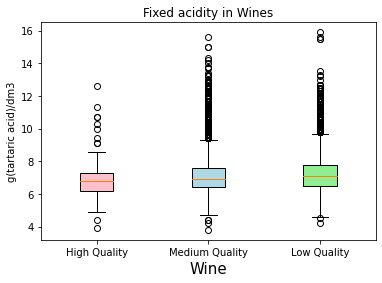

In [103]:
j=0
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title(cols[j].capitalize()+' in Wines')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('g(tartaric acid)/dm3')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Graph not very relevant - boxplots almost the same

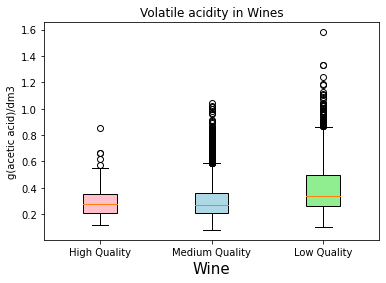

In [104]:
j=1
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title(cols[j].capitalize()+' in Wines')

plt.xlabel('Wine', fontsize=15)
plt.ylabel('g(acetic acid)/dm3')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Graph quite relevant: low-quality wines can have high volatile acidity GRAPH 6

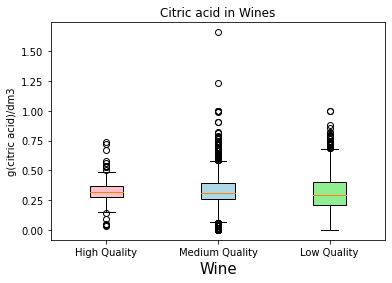

In [105]:
j=2
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title(cols[j].capitalize()+' in Wines')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('g(citric acid)/dm3')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Graph relevant: high or low amounts of citric acid mean the quality is lower

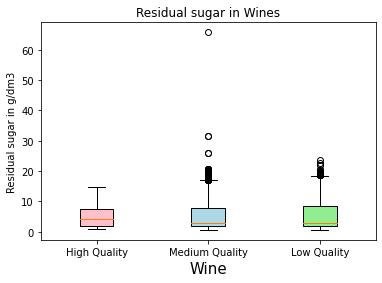

In [106]:
j=3
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title(cols[j].capitalize()+' in Wines')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('Residual sugar in g/dm3')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Graph not very relevant

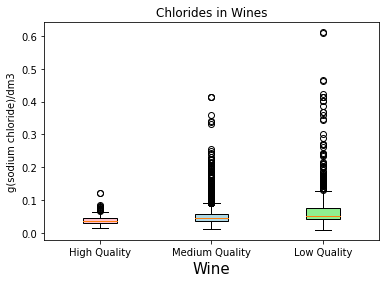

In [107]:
j=4
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title(cols[j].capitalize()+' in Wines')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('g(sodium chloride)/dm3')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Graph quite relevant: low-quality wines can have high chloride levels GRAPH 2

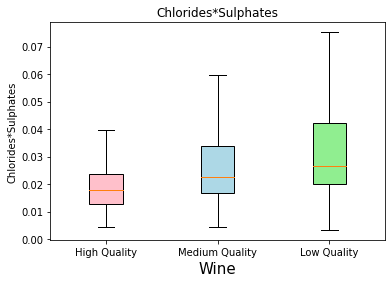

In [108]:
box=plt.boxplot ([np.array(high_qual.iloc[:,4])*np.array(high_qual.iloc[:,9]), np.array(med_qual.iloc[:,4])*np.array(med_qual.iloc[:,9]), np.array(low_qual.iloc[:,4])*np.array(low_qual.iloc[:,9])], patch_artist=True, sym='')
#axes= box.add_axes([0.1,0.1,0.8,0.8])
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title('Chlorides*Sulphates')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('Chlorides*Sulphates')
#plt.set_ylim([0,40000])
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Probably best graph: for low-quality wines, the product of chlorides and sulphates is larger.

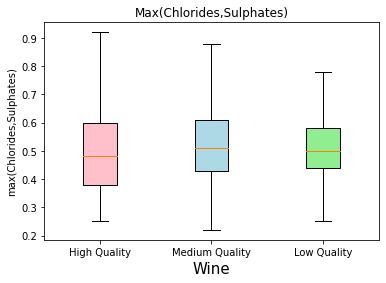

In [109]:
box=plt.boxplot ([np.array(np.maximum(high_qual.iloc[:,4],high_qual.iloc[:,9])), np.array(np.maximum(med_qual.iloc[:,4],med_qual.iloc[:,9])), np.array(np.maximum(low_qual.iloc[:,4],low_qual.iloc[:,9]))], patch_artist=True, sym='')
#axes= box.add_axes([0.1,0.1,0.8,0.8])
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title('Max(Chlorides,Sulphates)')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('max(Chlorides,Sulphates)')
#plt.set_ylim([0,40000])
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Not as good as the previous graph.

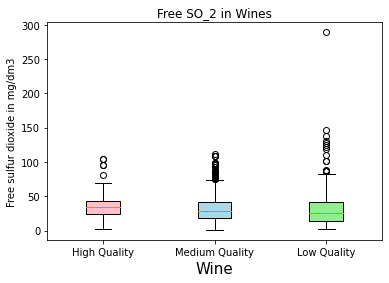

In [110]:
j=5
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title('Free SO_2 in Wines')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('Free sulfur dioxide in mg/dm3')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Graph not very relevant

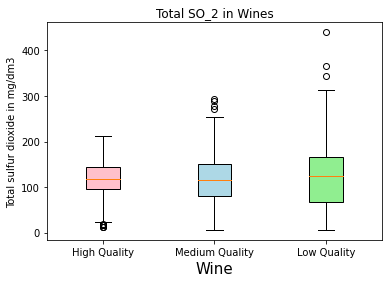

In [111]:
j=6
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title('Total SO_2 in Wines')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('Total sulfur dioxide in mg/dm3')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Graph maybe relevant - low-quality wines can habe high or low total levels of SO_2, high-quality are more uniform GRAPH 5


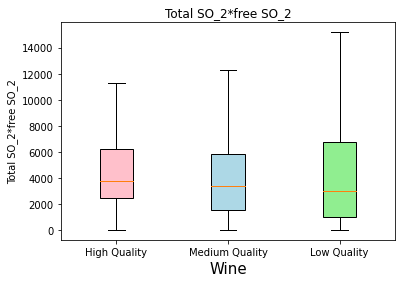

In [112]:
box=plt.boxplot ([np.array(high_qual.iloc[:,5])*np.array(high_qual.iloc[:,6]), np.array(med_qual.iloc[:,5])*np.array(med_qual.iloc[:,6]), np.array(low_qual.iloc[:,5])*np.array(low_qual.iloc[:,6])], patch_artist=True, sym='')
#axes= box.add_axes([0.1,0.1,0.8,0.8])
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title('Total SO_2*free SO_2')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('Total SO_2*free SO_2')
#plt.set_ylim([0,40000])
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Good graph: for low-quality wines, the product of total and free SO_2 is smaller.

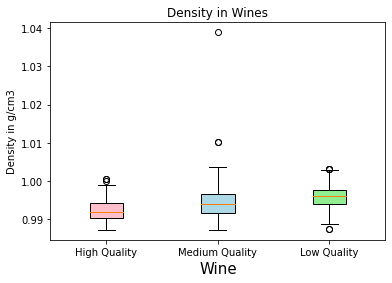

In [113]:
j=7
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title(cols[j].capitalize()+' in Wines')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('Density in g/cm3')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Graph relevant - low-quality wines have a higher density GRAPH 3

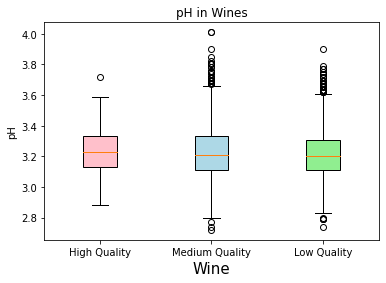

In [114]:
j=8
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title('pH in Wines')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('pH')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Graph not very relevant

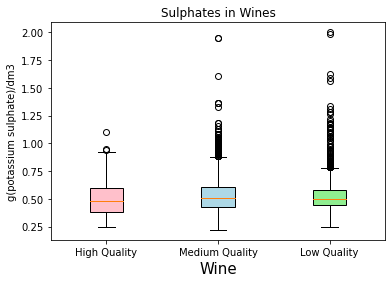

In [115]:
j=9
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title(cols[j].capitalize()+' in Wines')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('g(potassium sulphate)/dm3')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #Graph quite relevant - high-quality wines have less sulphates GRAPH 4

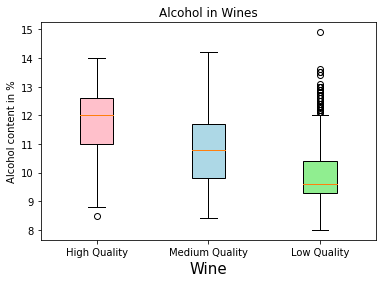

In [223]:
j=10
box=plt.boxplot ([high_qual.iloc[:,j], med_qual.iloc[:,j], low_qual.iloc[:,j]], patch_artist=True)
ticks = range(1, 4)
labels = list(['High Quality','Medium Quality','Low Quality'])
plt.xticks(ticks,labels)
plt.title(cols[j].capitalize()+' in Wines')
plt.xlabel('Wine', fontsize=15)
plt.ylabel('Alcohol content in %')
colors = ['pink', 'lightblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
    #most relevant graph - high-quality wines are more alcoholic GRAPH 1

In [213]:
wines.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,wine_type_code,wine_type,quality_label
0,7.0,0.17,0.74,12.8,0.045,24.0,126.0,0.99420,3.26,0.38,12.2,8,1,NaN,high
1,7.7,0.64,0.21,2.2,0.077,32.0,133.0,0.99560,3.27,0.45,9.9,5,0,NaN,low
2,6.8,0.39,0.34,7.4,0.020,38.0,133.0,0.99212,3.18,0.44,12.0,7,1,NaN,medium
3,6.3,0.28,0.47,11.2,0.040,61.0,183.0,0.99592,3.12,0.51,9.5,6,1,NaN,medium
4,7.4,0.35,0.20,13.9,0.054,63.0,229.0,0.99888,3.11,0.50,8.9,6,1,NaN,medium


In [8]:
#j=10
#box=sns.swarmplot (data=wines, x='alcohol', y='quality_label')
#ticks = range(1, 4)
#labels = list(['High Quality','Medium Quality','Low Quality'])
#plt.xticks(ticks,labels)
#plt.title(cols[j].capitalize()+' in Wines')
#plt.ylabel('Quality label')
#plt.xlabel('Alcohol content in %')
#colors = ['pink', 'lightblue', 'lightgreen']
#for patch, color in zip(box['boxes'], colors):
 #   patch.set_facecolor(color)
    #most relevant graph - high-quality wines are more alcoholic GRAPH 1
   

In [117]:
type(wines)

pandas.core.frame.DataFrame

In [118]:
wines.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,wine_type_code,wine_type,quality_label
0,7.0,0.17,0.74,12.8,0.045,24.0,126.0,0.99420,3.26,0.38,12.2,8,1,NaN,high
1,7.7,0.64,0.21,2.2,0.077,32.0,133.0,0.99560,3.27,0.45,9.9,5,0,NaN,low
2,6.8,0.39,0.34,7.4,0.020,38.0,133.0,0.99212,3.18,0.44,12.0,7,1,NaN,medium
3,6.3,0.28,0.47,11.2,0.040,61.0,183.0,0.99592,3.12,0.51,9.5,6,1,NaN,medium
4,7.4,0.35,0.20,13.9,0.054,63.0,229.0,0.99888,3.11,0.50,8.9,6,1,NaN,medium


In [119]:
r1 = pd.Series(range(11))
r2 = pd.Series([12])
final_range = r1.append(r2)
x=wines.iloc[:,final_range]
y=wines.iloc[:,11]
x_r=red_wine.iloc[:,:11]
y_r=red_wine.iloc[:,11]
x_w=white_wine.iloc[:,:11]
y_w=white_wine.iloc[:,11]

In [120]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size = 0.2)
Xw_train, Xw_test, Yw_train, Yw_test = train_test_split(x_w, y_w, test_size = 0.2)
Xr_train, Xr_test, Yr_train, Yr_test = train_test_split(x_r, y_r, test_size = 0.2)
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train.iloc[:,0:11] = scaler.fit_transform(X_train.iloc[:,0:11])
X_test.iloc[:,0:11] = scaler.transform(X_test.iloc[:,0:11])
Xw_train.iloc[:,0:11] = scaler.fit_transform(Xw_train.iloc[:,0:11])
Xw_test.iloc[:,0:11] = scaler.transform(Xw_test.iloc[:,0:11])
Xr_train.iloc[:,0:11] = scaler.fit_transform(Xr_train.iloc[:,0:11])
Xr_test.iloc[:,0:11] = scaler.transform(Xr_test.iloc[:,0:11])

/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:1736: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value[:, i].tolist())
/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:1736: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value[:, i].tolist())
/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas

In [121]:
Yw_train.head()

1695    6
450     5
4013    6
4302    6
3293    7
Name: quality, dtype: int64

In [122]:
#Linear Regression for all wines
regressor=LinearRegression()


regressor.fit(X_train,Y_train)
#print(regressor.coef_, regressor.intercept_)
#print(regressor.score(X_test,Y_test))
X_train = np.append (arr=np.ones([X_train.shape[0],1]).astype(int), values = X_train, axis = 1)
import statsmodels.api as sm
X_opt = [0,1,2,4,6,7,8,9,10,11,12]
regressor = sm.OLS(Y_train, X_train[:,X_opt]).fit()
print(regressor.summary())
#Result of OLS: most important indicators are all of them except citric acid, total sulfur dioxide, and chlorides. (White wines)
#All of them except citric acid and chlorides. (All wines)

                            OLS Regression Results                            
Dep. Variable:                quality   R-squared:                       0.299
Model:                            OLS   Adj. R-squared:                  0.298
Method:                 Least Squares   F-statistic:                     221.3
Date:                Wed, 09 Dec 2020   Prob (F-statistic):               0.00
Time:                        10:51:35   Log-Likelihood:                -5762.9
No. Observations:                5197   AIC:                         1.155e+04
Df Residuals:                    5186   BIC:                         1.162e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          6.0788      0.048    125.631      0.0

In [123]:
#Linear Regression for red wines
regressor=LinearRegression()


regressor.fit(Xr_train,Yr_train)
#print(regressor.coef_, regressor.intercept_)
#print(regressor.score(X_test,Y_test))
Xr_train = np.append (arr=np.ones([Xr_train.shape[0],1]).astype(int), values = Xr_train, axis = 1)
import statsmodels.api as sm
X_opt = [0,1,2,4,5,7,8,10]
regressor = sm.OLS(Yr_train, Xr_train[:,X_opt]).fit()
print(regressor.summary())
#Result of OLS: most important indicators are all of them except citric acid, free sulfur dioxide, pH.

                            OLS Regression Results                            
Dep. Variable:                quality   R-squared:                       0.311
Model:                            OLS   Adj. R-squared:                  0.308
Method:                 Least Squares   F-statistic:                     82.08
Date:                Wed, 09 Dec 2020   Prob (F-statistic):           1.95e-98
Time:                        10:51:36   Log-Likelihood:                -1316.9
No. Observations:                1279   AIC:                             2650.
Df Residuals:                    1271   BIC:                             2691.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          5.6403      0.019    296.784      0.0

In [124]:
#Evaluation of Linear Regression
q=[]
for j in range(Y_test.size):
    p=[1]
    for i in range(15):
        if i+1 in X_opt:
            p.append(X_test.iloc[j,i])
    q.append(round(float(regressor.predict(p))))
#
print(confusion_matrix(q, Y_test.iloc[0:Y_test.size]))
accuracy_score(q, Y_test.iloc[0:Y_test.size])
#accuracy: 55%. The prediction has limited results


[[  0   0   0   0   0   0   0]
 [  0   0   0   1   0   0   0]
 [  2  22 262 192  28   6   0]
 [  2  19 145 382 190  32   1]
 [  0   0   1   8   7   0   0]
 [  0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0]]


0.5007692307692307

In [125]:
#Polynomial Regression
from sklearn.preprocessing import PolynomialFeatures
poly_reg=PolynomialFeatures(degree=2)
X_poly=poly_reg.fit_transform(x)
#print(X_poly)
X_train, X_test, Y_train, Y_test = train_test_split(X_poly, y, test_size = 0.2)
regressor=LinearRegression()
regressor.fit(X_train,Y_train)
X_train = np.append (arr=np.ones([X_train.shape[0],1]).astype(int), values = X_train, axis = 1)
import statsmodels.api as sm
X_opt = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91]
X_opt.pop(87)
X_opt.pop(15)
X_opt.pop(76)
X_opt.pop(72)
X_opt.pop(28)
X_opt.pop(43)
X_opt.pop(39)
X_opt.pop(18)
X_opt.pop(22)
X_opt.pop(9)
X_opt.pop(2)
X_opt.pop(24)
X_opt.pop(68)
X_opt.pop(26)
X_opt.pop(65)
X_opt.pop(26)
X_opt.pop(73)
X_opt.pop(51)
X_opt.pop(21)
X_opt.pop(16)
X_opt.pop(50)
X_opt.pop(20)
X_opt.pop(3)
X_opt.pop(47)
X_opt.pop(53)
X_opt.pop(41)
X_opt.pop(21)
X_opt.pop(47)
X_opt.pop(60)
X_opt.pop(40)
X_opt.pop(10)
X_opt.pop(35)
X_opt.pop(38)
X_opt.pop(29)
X_opt.pop(27)
X_opt.pop(27)
X_opt.pop(53)
X_opt.pop(54)
X_opt.pop(25)
X_opt.pop(3)
X_opt.pop(15)
X_opt.pop(22)
X_opt.pop(13)
X_opt.pop(20)
X_opt.pop(9)
X_opt.pop(9)
X_opt.pop(9)
X_opt.pop(16)
X_opt.pop(22)
X_opt.pop(12)
X_opt.pop(9)
X_opt.pop(22)
X_opt.pop(37)
X_opt.pop(38)
X_opt.pop(22)
X_opt.pop(16)
X_opt.pop(3)
X_opt.pop(32)
X_opt.pop(10)
X_opt.pop(29)
X_opt.pop(22)
X_opt.pop(17)
X_opt.pop(12)
X_opt.pop(24)
X_opt.pop(22)
X_opt.pop(14)
X_opt.pop(18)
X_opt.pop(18)
X_opt.pop(13)
X_opt.pop(5)
X_opt.pop(3)
X_opt.pop(19)
X_opt.pop(8)
X_opt.pop(8)
X_opt.pop(7)
X_opt.pop(6)
X_opt.pop(15)
X_opt.pop(9)
X_opt.pop(11)
X_opt.pop(6)
X_opt.pop(6)
X_opt.pop(10)
X_opt.pop(9)
X_opt.pop(4)
X_opt.pop(5)
X_opt.pop(3)
regressor = sm.OLS(Y_train, X_train[:,X_opt]).fit()
print(regressor.summary())
#print(X_opt)
poly_reg.fit_transform(wines.iloc[:,0:13])[0,:]

                            OLS Regression Results                            
Dep. Variable:                quality   R-squared:                       0.259
Model:                            OLS   Adj. R-squared:                  0.258
Method:                 Least Squares   F-statistic:                     453.3
Date:                Wed, 09 Dec 2020   Prob (F-statistic):               0.00
Time:                        10:51:40   Log-Likelihood:                -5894.2
No. Observations:                5197   AIC:                         1.180e+04
Df Residuals:                    5192   BIC:                         1.183e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.4140      0.054     26.156      0.0

array([    1.  ,     7.  ,     0.17,     0.74,    12.8 ,     0.04,    24.  ,   126.  ,     0.99,     3.26,     0.38,    12.2 ,     8.  ,     1.  ,
          49.  ,     1.19,     5.18,    89.6 ,     0.32,   168.  ,   882.  ,     6.96,    22.82,     2.66,    85.4 ,    56.  ,     7.  ,     0.03,
           0.13,     2.18,     0.01,     4.08,    21.42,     0.17,     0.55,     0.06,     2.07,     1.36,     0.17,     0.55,     9.47,     0.03,
          17.76,    93.24,     0.74,     2.41,     0.28,     9.03,     5.92,     0.74,   163.84,     0.58,   307.2 ,  1612.8 ,    12.73,    41.73,
           4.86,   156.16,   102.4 ,    12.8 ,     0.  ,     1.08,     5.67,     0.04,     0.15,     0.02,     0.55,     0.36,     0.04,   576.  ,
        3024.  ,    23.86,    78.24,     9.12,   292.8 ,   192.  ,    24.  , 15876.  ,   125.27,   410.76,    47.88,  1537.2 ,  1008.  ,   126.  ,
           0.99,     3.24,     0.38,    12.13,     7.95,     0.99,    10.63,     1.24,    39.77,    26.08,     3.26,  

In [126]:
#Eval of Polyn Regression
q=[]
for j in range(Y_test.size):
    p=[1]
    for i in range(90):
        if i+1 in X_opt:
            p.append(X_test[j,i])
    q.append(round(float(regressor.predict(p))))
#
print(confusion_matrix(q, Y_test.iloc[0:Y_test.size]))
accuracy_score(q, Y_test.iloc[0:Y_test.size])
#55,2%, barely more than the linear regression

[[  0   0   0   0   0   0]
 [  1   0   0   0   0   0]
 [  4  24 217  87  13   6]
 [  2  22 217 433 157  25]
 [  0   0   3  47  35   7]
 [  0   0   0   0   0   0]]


0.5269230769230769

In [202]:
scaler = StandardScaler()
#X_train.iloc[:,0:11] = scaler.fit_transform(X_train.iloc[:,0:11])
#X_test.iloc[:,0:11] = scaler.transform(X_test.iloc[:,0:11])
x.iloc[:,0:11]=scaler.fit_transform(x.iloc[:,0:11])
X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size = 0.2, random_state=0)

/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:1736: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value[:, i].tolist())


In [208]:
from sklearn.svm import SVR
regressor=SVR(kernel='rbf')
regressor.fit(X_train,Y_train)


SVR()

In [209]:
q=[]
for j in range(Y_test.size):
    pippo=np.array(X_test.iloc[j,:]).reshape(1,- 1)
    q.append(round(float(regressor.predict(pippo))))
q=np.array(q)


#for j in range(Y_test.size):
    #p=[]
    #for i in range(11):
        #if i+1 in X_opt:
     #      p.append(X_test.iloc[j,i])
    #q.append(p)
    #q.append(float(regressor.predict(p)))
#scaler.inverse_transform(q)

In [210]:
print(confusion_matrix(q, Y_test))
print(accuracy_score(q, Y_test))
from sklearn.metrics import r2_score
print(r2_score(Y_test,q)) 
#0.59 is better than the previous results. Let's go on...

[[  0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0]
 [  3  35 280 122  11   0   0]
 [  1   7 131 418 141  20   1]
 [  0   0   3  43  69  15   0]
 [  0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0]]
0.59
0.28474708825088224


In [207]:
#Decision Tree Regression
from sklearn.tree import DecisionTreeRegressor
regressor=DecisionTreeRegressor(random_state=0)
regressor.fit(X_train,Y_train)
q=[]
for j in range(Y_test.size):
    pippo=np.array(X_test.iloc[j,:]).reshape(1,- 1)
    q.append(round(float(regressor.predict(pippo))))
q=np.array(q)
print(confusion_matrix(q, Y_test.iloc[0:Y_test.size]))
print(accuracy_score(q, Y_test.iloc[0:Y_test.size]))
print(r2_score(Y_test.iloc[0:Y_test.size],q)) 
#61% is even better!

[[  0   0   5   4   0   0   0]
 [  2  15  15  10   4   1   0]
 [  2  16 285 128  19   3   0]
 [  0  11  84 352  66   8   1]
 [  0   0  23  80 121   8   0]
 [  0   0   2   9  11  15   0]
 [  0   0   0   0   0   0   0]]
0.6061538461538462
0.054731834692795966


In [206]:
#Random Forest Regression
from sklearn.ensemble import RandomForestRegressor
regressor=RandomForestRegressor(n_estimators=10, random_state=0)
regressor.fit(X_train,Y_train)
q=[]
for j in range(Y_test.size):
    pippo=np.array(X_test.iloc[j,:]).reshape(1,- 1)
    q.append(round(float(regressor.predict(pippo))))
q=np.array(q)
print(confusion_matrix(q, Y_test.iloc[0:Y_test.size]))
print(accuracy_score(q, Y_test.iloc[0:Y_test.size]))
print(r2_score(Y_test.iloc[0:Y_test.size],q)) 
#67,5% is significantly better than all other results

[[  0   0   0   0   0   0   0]
 [  0   4   0   0   0   0   0]
 [  2  34 293  77   7   2   1]
 [  2   4 120 465 106  13   0]
 [  0   0   1  41 108  12   0]
 [  0   0   0   0   0   8   0]
 [  0   0   0   0   0   0   0]]
0.6753846153846154
0.42233612120115305


In [133]:
#Categorization: 
#out of 460 low-quality wines, 333 labeled as low, rest as medium (acc. 72%)
#out of 804 medium-quality wines, 84 labeled as low, rest as medium (acc. 90%)
#out of 36 high-quality wines, 3 labeled low, 25 medium, 8 high (acc. 22%)
#total: 82%

In [134]:
#New Idea: Only 3 classes (low/med/high)
yIsLow=list(map(lambda z: int(z<6), y))
yIsHi=list(map(lambda z: int(z>7), y))
#yIsLow

In [135]:
from sklearn.linear_model import LogisticRegression
classifier=LogisticRegression()
X_train, X_test, Y_train, Y_test = train_test_split(x, yIsLow, test_size = 0.2, random_state=0)
classifier.fit(X_train, Y_train)

LogisticRegression()

In [136]:
y_pred=classifier.predict(X_test)
#print(np.concatenate((y_pred.reshape(len(y_pred),1), (np.array(Y_test)).reshape(len(np.array(Y_test)),1)),1))
print(confusion_matrix(y_pred, Y_test))
accuracy_score(y_pred, Y_test)
#84% is slightly better than what we got by going grade by grade (82%)

[[710 184]
 [130 276]]


0.7584615384615384

In [137]:
X_train, X_test, Y_train, Y_test = train_test_split(x, yIsHi, test_size = 0.2, random_state=0)
classifier.fit(X_train, Y_train)
y_pred=classifier.predict(X_test)
print(confusion_matrix(y_pred, Y_test))
accuracy_score(y_pred, Y_test)
#Simple logistic regression labels NONE of the wines as high-quality.
#Random Forest labels 13 of them, all of them correctly. 

[[1264   36]
 [   0    0]]


0.9723076923076923

In [138]:
from sklearn.ensemble import RandomForestClassifier
classifier=RandomForestClassifier(n_estimators=100, criterion='entropy')
X_train, X_test, Y_train, Y_test = train_test_split(x, yIsLow, test_size = 0.2, random_state=0)
classifier.fit(X_train,Y_train)

RandomForestClassifier(criterion='entropy')

In [139]:
#Statistical Significance Tests
from scipy import stats

for j in range(11):
    F, p = stats.f_oneway(wines[wines['quality_label'] == 'low'].iloc[:,j],
    wines[wines['quality_label'] == 'medium'].iloc[:,j],
    wines[wines['quality_label'] == 'high'].iloc[:,j])
    print('ANOVA test for mean', end=' ')
    print(cols[j], end=' ')
    print('levels across wine samples with different quality ratings:')
    print('F Statistic:', F, '\tp-value:', p)

ANOVA test for mean fixed acidity levels across wine samples with different quality ratings:
F Statistic: 20.381638498376496 	p-value: 1.4997963980511249e-09
ANOVA test for mean volatile acidity levels across wine samples with different quality ratings:
F Statistic: 250.3391447532201 	p-value: 1.8472285967281885e-105
ANOVA test for mean citric acid levels across wine samples with different quality ratings:
F Statistic: 18.9689014227371 	p-value: 6.1077442166569355e-09
ANOVA test for mean residual sugar levels across wine samples with different quality ratings:
F Statistic: 3.432938987382213 	p-value: 0.032350509691691995
ANOVA test for mean chlorides levels across wine samples with different quality ratings:
F Statistic: 120.9601368520098 	p-value: 2.645627533466762e-52
ANOVA test for mean free SO_2 levels across wine samples with different quality ratings:
F Statistic: 10.312540552928878 	p-value: 3.3761187237755544e-05
ANOVA test for mean total SO_2 levels across wine samples with di

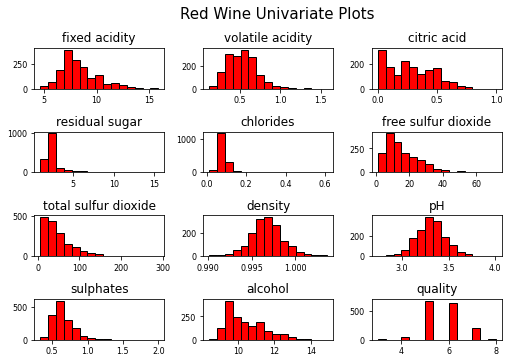

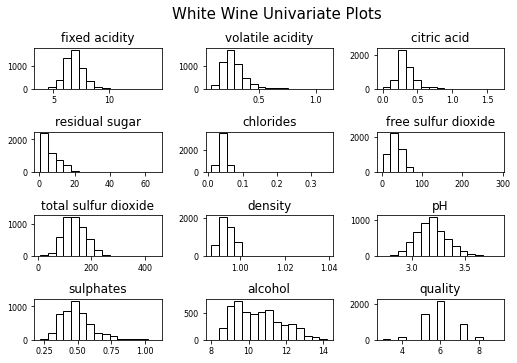

In [140]:
#Univariate Analysis
red_wine.iloc[:,0:12].hist(bins=15, color='red', edgecolor='black', linewidth=1.0,
xlabelsize=8, ylabelsize=8, grid=False)

plt.tight_layout(rect=(0, 0, 1.2, 1.2))

rt = plt.suptitle('Red Wine Univariate Plots', x=0.65, y=1.25, fontsize=15)

white_wine.iloc[:,0:12].hist(bins=15, color='white', edgecolor='black', linewidth=1.0,
xlabelsize=8, ylabelsize=8, grid=False)

plt.tight_layout(rect=(0, 0, 1.2, 1.2))

rt = plt.suptitle('White Wine Univariate Plots', x=0.65, y=1.25, fontsize=15)

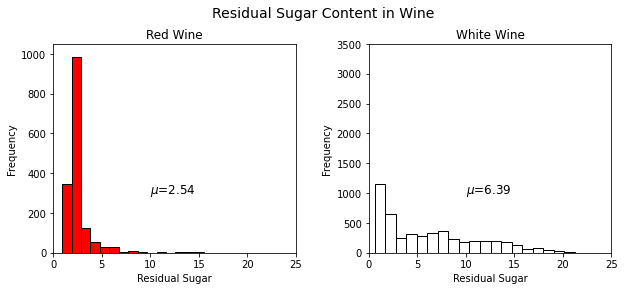

In [141]:
#Couples of Plots for a single feature:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("Residual Sugar Content in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("Residual Sugar")
ax1.set_ylabel("Frequency")
ax1.set_ylim([0, 1050])
ax1.set_xlim([0, 25])
ax1.text(10, 300, r'$\mu$='+str(round(red_wine['residual sugar'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['residual sugar'], color='red', bins=15,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("Residual Sugar")
ax2.set_ylabel("Frequency")
ax2.set_xlim([0, 25])
ax2.set_ylim([0, 3500])
ax2.text(10, 1000, r'$\mu$='+str(round(white_wine['residual sugar'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['residual sugar'], color='white', bins=60,
edgecolor='black', linewidth=1)

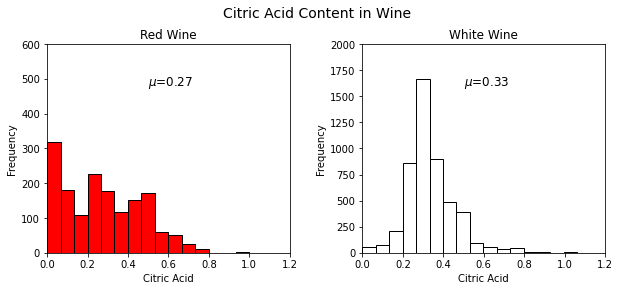

In [142]:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("Citric Acid Content in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("Citric Acid")
ax1.set_ylabel("Frequency")
ax1.set_ylim([0, 600])
ax1.set_xlim([0, 1.2])
ax1.text(0.5, 480, r'$\mu$='+str(round(red_wine['citric acid'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['citric acid'], color='red', bins=15,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("Citric Acid")
ax2.set_ylabel("Frequency")
ax2.set_xlim([0, 1.2])
ax2.set_ylim([0, 2000])
ax2.text(0.5, 1600, r'$\mu$='+str(round(white_wine['citric acid'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['citric acid'], color='white', bins=25,
edgecolor='black', linewidth=1)

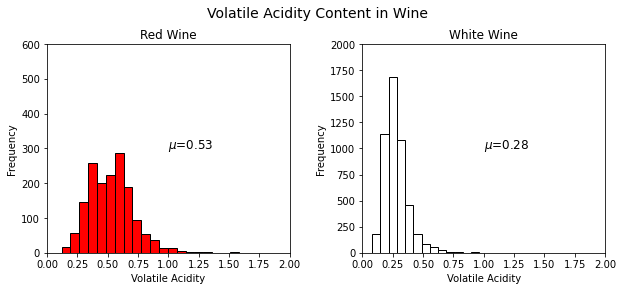

In [143]:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("Volatile Acidity Content in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("Volatile Acidity")
ax1.set_ylabel("Frequency")
ax1.set_ylim([0, 600])
ax1.set_xlim([0, 2])
ax1.text(1, 300, r'$\mu$='+str(round(red_wine['volatile acidity'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['volatile acidity'], color='red', bins=20,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("Volatile Acidity")
ax2.set_ylabel("Frequency")
ax2.set_xlim([0, 2])
ax2.set_ylim([0, 2000])
ax2.text(1, 1000, r'$\mu$='+str(round(white_wine['volatile acidity'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['volatile acidity'], color='white', bins=15,
edgecolor='black', linewidth=1)



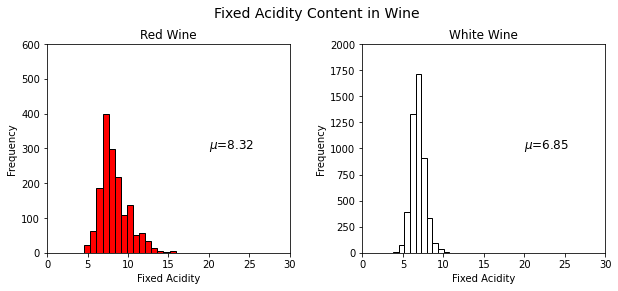

In [144]:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("Fixed Acidity Content in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("Fixed Acidity")
ax1.set_ylabel("Frequency")
ax1.set_ylim([0, 600])
ax1.set_xlim([0, 30])
ax1.text(20, 300, r'$\mu$='+str(round(red_wine['fixed acidity'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['fixed acidity'], color='red', bins=15,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("Fixed Acidity")
ax2.set_ylabel("Frequency")
ax2.set_xlim([0, 30])
ax2.set_ylim([0, 2000])
ax2.text(20, 1000, r'$\mu$='+str(round(white_wine['fixed acidity'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['fixed acidity'], color='white', bins=15,
edgecolor='black', linewidth=1)

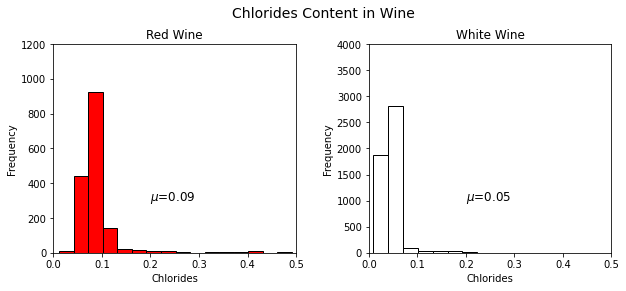

In [145]:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("Chlorides Content in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("Chlorides")
ax1.set_ylabel("Frequency")
ax1.set_ylim([0, 1200])
ax1.set_xlim([0, 0.5])
ax1.text(0.2, 300, r'$\mu$='+str(round(red_wine['chlorides'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['chlorides'], color='red', bins=20,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("Chlorides")
ax2.set_ylabel("Frequency")
ax2.set_xlim([0, 0.5])
ax2.set_ylim([0, 4000])
ax2.text(0.2, 1000, r'$\mu$='+str(round(white_wine['chlorides'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['chlorides'], color='white', bins=11,
edgecolor='black', linewidth=1)

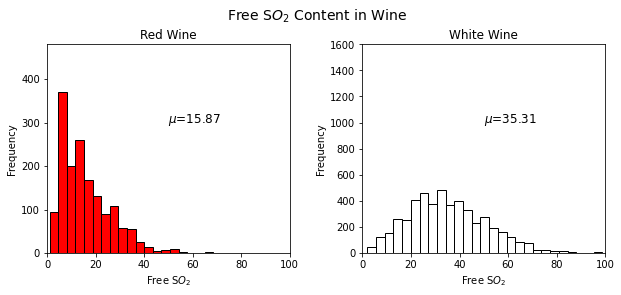

In [146]:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("Free S"+r'$O_2$'+" Content in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("Free S"+r'$O_2$')
ax1.set_ylabel("Frequency")
ax1.set_ylim([0, 480])
ax1.set_xlim([0, 100])
ax1.text(50, 300, r'$\mu$='+str(round(red_wine['free sulfur dioxide'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['free sulfur dioxide'], color='red', bins=20,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("Free S"+r'$O_2$')
ax2.set_ylabel("Frequency")
ax2.set_xlim([0, 100])
ax2.set_ylim([0, 1600])
ax2.text(50, 1000, r'$\mu$='+str(round(white_wine['free sulfur dioxide'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['free sulfur dioxide'], color='white', bins=80,
edgecolor='black', linewidth=1)

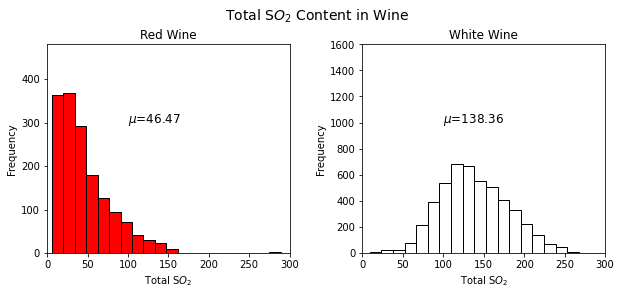

In [147]:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("Total S"+r'$O_2$'+" Content in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("Total S"+r'$O_2$')
ax1.set_ylabel("Frequency")
ax1.set_ylim([0, 480])
ax1.set_xlim([0, 300])
ax1.text(100, 300, r'$\mu$='+str(round(red_wine['total sulfur dioxide'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['total sulfur dioxide'], color='red', bins=20,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("Total S"+r'$O_2$')
ax2.set_ylabel("Frequency")
ax2.set_xlim([0, 300])
ax2.set_ylim([0, 1600])
ax2.text(100, 1000, r'$\mu$='+str(round(white_wine['total sulfur dioxide'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['total sulfur dioxide'], color='white', bins=30,
edgecolor='black', linewidth=1)

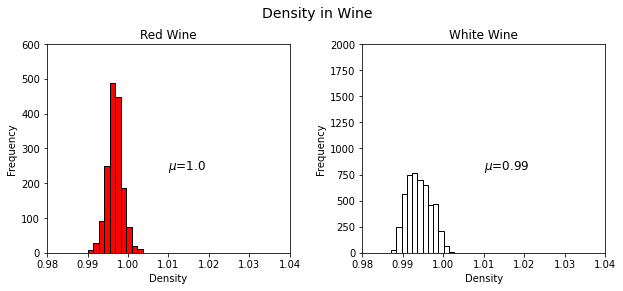

In [148]:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("Density in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("Density")
ax1.set_ylabel("Frequency")
ax1.set_xlim([0.98, 1.04])
ax1.set_ylim([0,600])
ax1.text(1.01, 240, r'$\mu$='+str(round(red_wine['density'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['density'], color='red', bins=10,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("Density")
ax2.set_ylabel("Frequency")
ax2.set_xlim([0.98, 1.04])
ax2.set_ylim([0,2000])
ax2.text(1.01, 800, r'$\mu$='+str(round(white_wine['density'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['density'], color='white', bins=40,
edgecolor='black', linewidth=1)

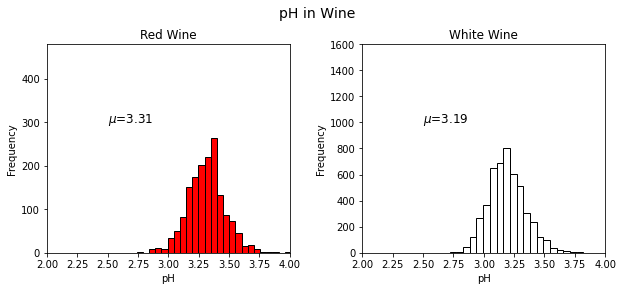

In [149]:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("pH in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("pH")
ax1.set_ylabel("Frequency")
ax1.set_ylim([0, 480])
ax1.set_xlim([2, 4])
ax1.text(2.5, 300, r'$\mu$='+str(round(red_wine['pH'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['pH'], color='red', bins=25,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("pH")
ax2.set_ylabel("Frequency")
ax2.set_xlim([2, 4])
ax2.set_ylim([0, 1600])
ax2.text(2.5, 1000, r'$\mu$='+str(round(white_wine['pH'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['pH'], color='white', bins=20,
edgecolor='black', linewidth=1)

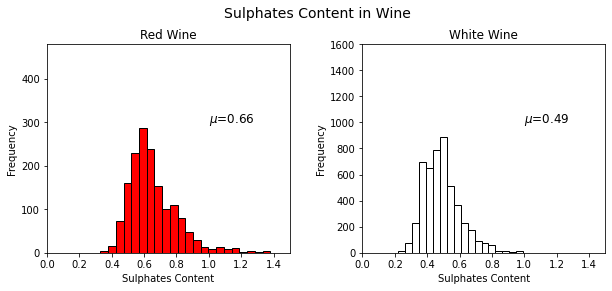

In [150]:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("Sulphates Content in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("Sulphates Content")
ax1.set_ylabel("Frequency")
ax1.set_ylim([0, 480])
ax1.set_xlim([0, 1.5])
ax1.text(1, 300, r'$\mu$='+str(round(red_wine['sulphates'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['sulphates'], color='red', bins=35,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("Sulphates Content")
ax2.set_ylabel("Frequency")
ax2.set_xlim([0, 1.5])
ax2.set_ylim([0, 1600])
ax2.text(1, 1000, r'$\mu$='+str(round(white_wine['sulphates'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['sulphates'], color='white', bins=20,
edgecolor='black', linewidth=1)

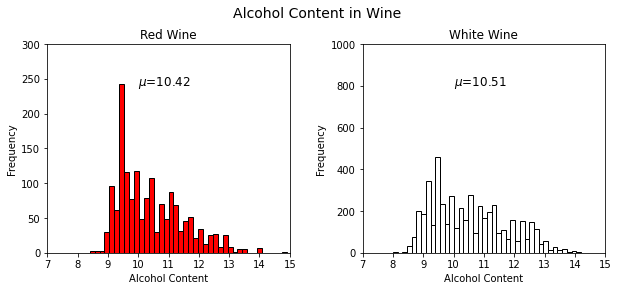

In [151]:
fig = plt.figure(figsize = (10,4))
title = fig.suptitle("Alcohol Content in Wine", fontsize=14)
fig.subplots_adjust(top=0.85, wspace=0.3)
ax1 = fig.add_subplot(1,2, 1)
ax1.set_title("Red Wine")
ax1.set_xlabel("Alcohol Content")
ax1.set_ylabel("Frequency")
ax1.set_ylim([0, 300])
ax1.set_xlim([7, 15])
ax1.text(10, 240, r'$\mu$='+str(round(red_wine['alcohol'].mean(),2)),
fontsize=12)
r_freq, r_bins, r_patches = ax1.hist(red_wine['alcohol'], color='red', bins=40,
edgecolor='black', linewidth=1)
ax2 = fig.add_subplot(1,2, 2)
ax2.set_title("White Wine")
ax2.set_xlabel("Alcohol Content")
ax2.set_ylabel("Frequency")
ax2.set_xlim([7, 15])
ax2.set_ylim([0, 1000])
ax2.text(10, 800, r'$\mu$='+str(round(white_wine['alcohol'].mean(),2)),
fontsize=12)
w_freq, w_bins, w_patches = ax2.hist(white_wine['alcohol'], color='white', bins=40,
edgecolor='black', linewidth=1)

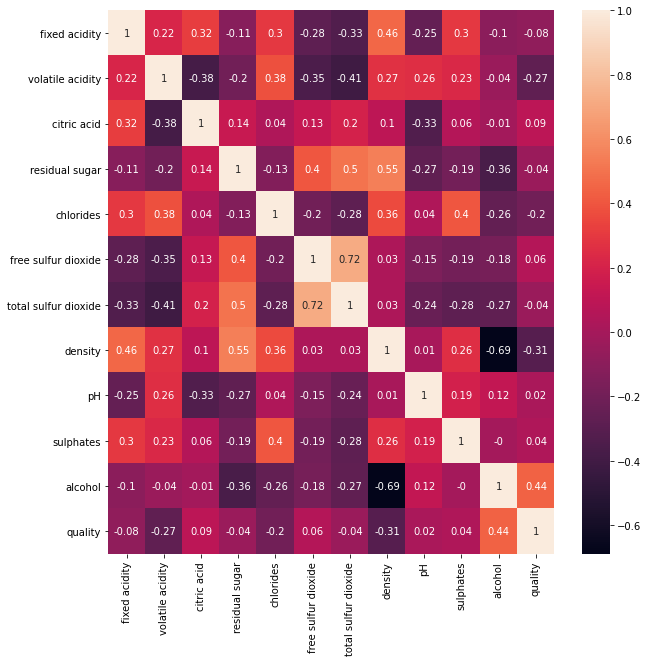

In [152]:
#Correlation Matrix
df_small = wines.iloc[:,:12]
fig, ax = plt.subplots(figsize=(10,10))
correlation_mat = df_small.corr()
correlation_mat = correlation_mat.round(2)
sns.heatmap(correlation_mat, annot = True, ax=ax)

plt.show()

In [153]:
#Correlation Matrix with Products
import scipy
for j in range(91):
    print(j,scipy.stats.pearsonr(X_poly[:,j], y)[0])
#Nothing special. Just that alcohol might be a better marker of quality if squared.

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
0 nan
1 -0.07674320790961989
2 -0.2656994776114679
3 0.08553171718367847
4 -0.036980484585769434
5 -0.20066550043510206
6 0.05546305861663267
7 -0.04138545385560883
8 -0.30585790606941393
9 0.019505703714435867
10 0.03848544587651445
11 0.44431852000765437
12 0.11932328463611316
13 -0.0641826953018597
14 -0.25108630685436845
15 0.04480207971967507
16 -0.04414206037111576
17 -0.17839683103933524
18 0.034110528738591786
19 -0.07092186221191557
20 -0.08078415525931151
21 -0.07508424965488322
22 -0.001979287765917069
23 0.170462611404981
24 0.09170854368111184
25 -0.2533929358346572
26 -0.08696653369034768
27 -0.13072720651406367
28 -0.2527489757000642
29 -0.11551614734757591
30 -0.21276403973894192
31 -0.26707308711403055
32 -0.25461594778401503
33 -0.18411843320970644
34 -0.15

In [154]:
#Correlation Matrix with Products
import scipy
#import math
for j in range(10):
    print(scipy.stats.pearsonr((X_poly[:,11])**j, y)[:])

(nan, nan)
(0.44431852000765437, 1.49754444768e-312)
(0.4461745649769398, 1.84556491e-315)
(0.44600351468766475, 3.427673273e-315)
(0.4437810067005464, 1.0340146871045e-311)
(0.43954298124515695, 3.784596940156141e-305)
(0.4333799897957436, 9.065447905719421e-296)
(0.4254271535802272, 5.972955656104708e-284)
(0.41585168865826716, 3.894145857449655e-270)
(0.4048400404719096, 8.496725185895538e-255)


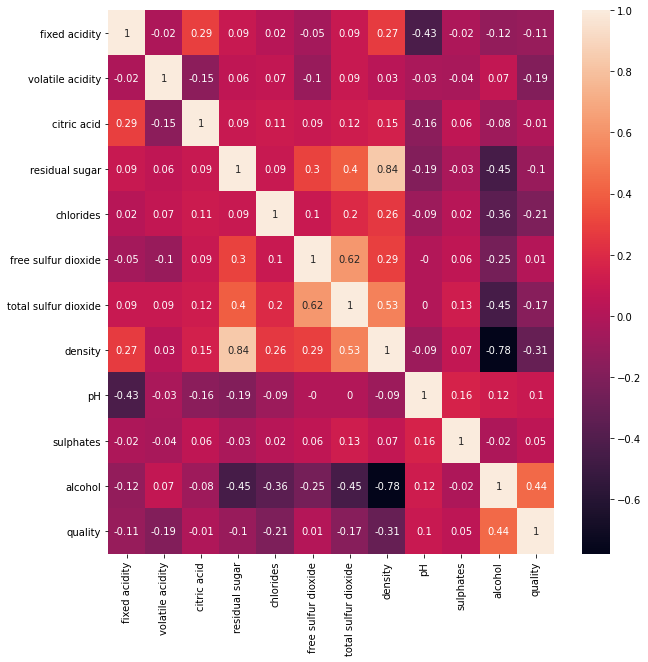

In [155]:
#Correlation Matrix for Red Wines
df_small = wines[wines['wine_type_code']==1].iloc[:,:12]
fig, ax = plt.subplots(figsize=(10,10))
correlation_mat = df_small.corr()
correlation_mat = correlation_mat.round(2)
sns.heatmap(correlation_mat, annot = True, ax=ax)

plt.show()

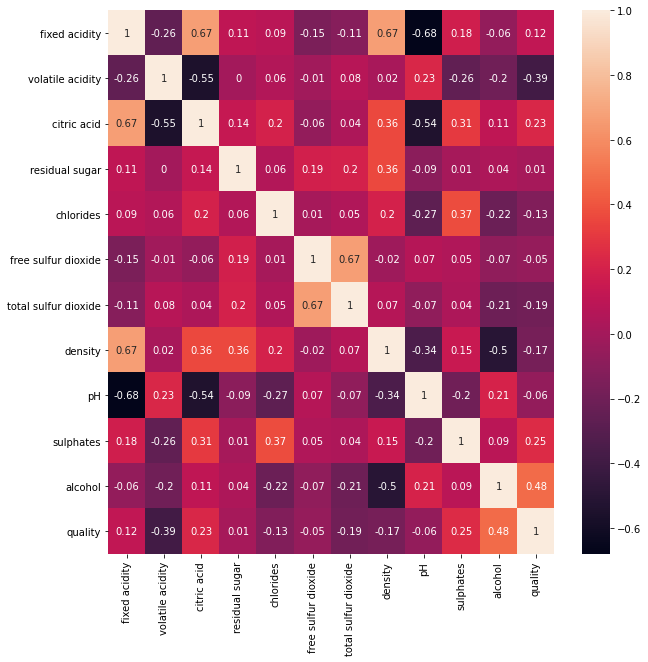

In [156]:
#Correlation Matrix for White Wines
df_small = wines[wines['wine_type_code']==0].iloc[:,:12]
fig, ax = plt.subplots(figsize=(10,10))
correlation_mat = df_small.corr()
correlation_mat = correlation_mat.round(2)
sns.heatmap(correlation_mat, annot = True, ax=ax)

plt.show()

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


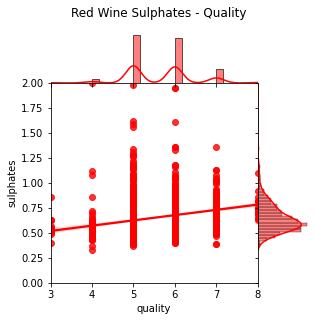

In [157]:
#Joint Plots
rj = sns.jointplot(x='quality', y='sulphates', data=red_wine,
kind='reg', ylim=(0, 2),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine Sulphates - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


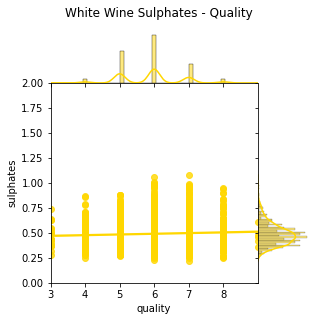

In [158]:
#Joint Plots
rj = sns.jointplot(x='quality', y='sulphates', data=white_wine,
kind='reg', ylim=(0, 2),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine Sulphates - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


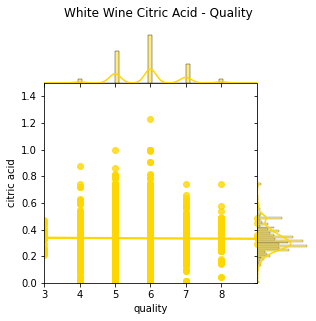

In [159]:
#Joint Plots
rj = sns.jointplot(x='quality', y='citric acid', data=white_wine,
kind='reg', ylim=(0, 1.5),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine Citric Acid - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


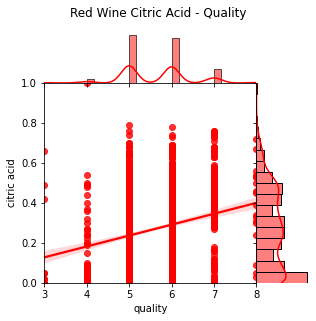

In [160]:
#Joint Plots
rj = sns.jointplot(x='quality', y='citric acid', data=red_wine,
kind='reg', ylim=(0, 1),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine Citric Acid - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


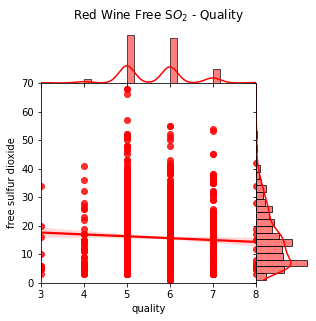

In [161]:
#Joint Plots
rj = sns.jointplot(x='quality', y='free sulfur dioxide', data=red_wine,
kind='reg', ylim=(0, 70),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine Free S'+r'$O_2$'+" - Quality", fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


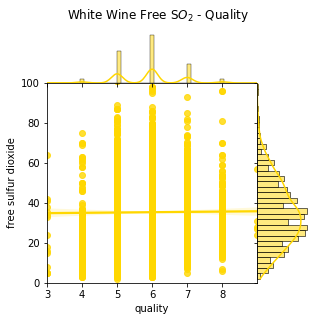

In [162]:
#Joint Plots
rj = sns.jointplot(x='quality', y='free sulfur dioxide', data=white_wine,
kind='reg', ylim=(0, 100),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine Free S'+r'$O_2$'+" - Quality", fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


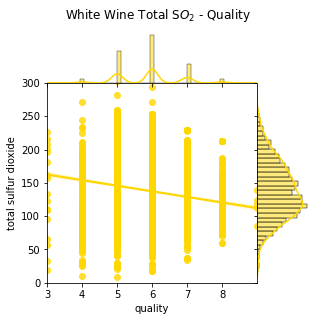

In [163]:
#Joint Plots
rj = sns.jointplot(x='quality', y='total sulfur dioxide', data=white_wine,
kind='reg', ylim=(0, 300),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine Total S'+r'$O_2$'+" - Quality", fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


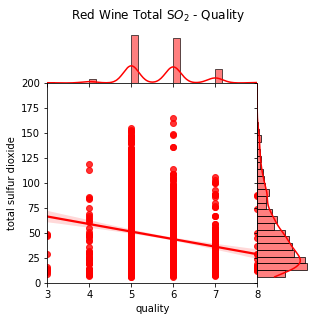

In [164]:
#Joint Plots
rj = sns.jointplot(x='quality', y='total sulfur dioxide', data=red_wine,
kind='reg', ylim=(0, 200),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine Total S'+r'$O_2$'+" - Quality", fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


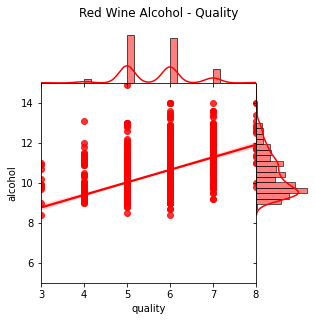

In [165]:
#Joint Plots
rj = sns.jointplot(x='quality', y='alcohol', data=red_wine,
kind='reg', ylim=(5, 15),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine Alcohol - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


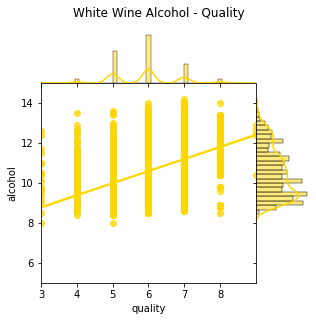

In [166]:
#Joint Plots
rj = sns.jointplot(x='quality', y='alcohol', data=white_wine,
kind='reg', ylim=(5, 15),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine Alcohol - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


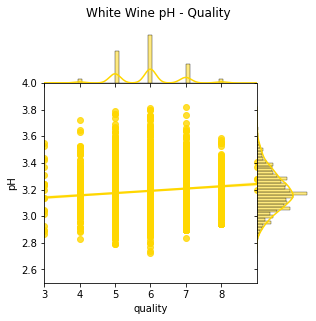

In [167]:
#Joint Plots
rj = sns.jointplot(x='quality', y='pH', data=white_wine,
kind='reg', ylim=(2.5, 4),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine pH - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


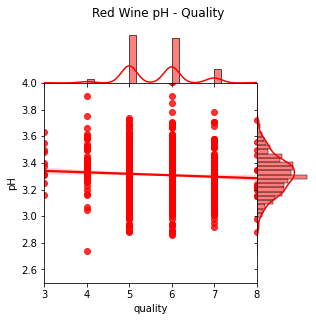

In [168]:
#Joint Plots
rj = sns.jointplot(x='quality', y='pH', data=red_wine,
kind='reg', ylim=(2.5, 4),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine pH - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


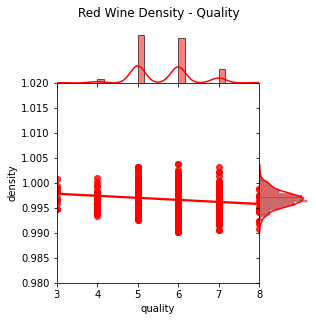

In [169]:
#Joint Plots
rj = sns.jointplot(x='quality', y='density', data=red_wine,
kind='reg', ylim=(0.98, 1.02),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine Density - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


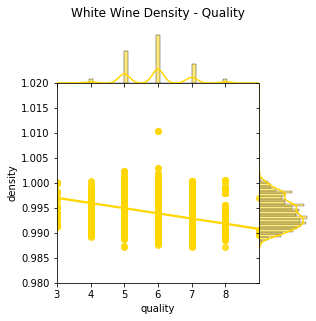

In [170]:
#Joint Plots
rj = sns.jointplot(x='quality', y='density', data=white_wine,
kind='reg', ylim=(0.98, 1.02),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine Density - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


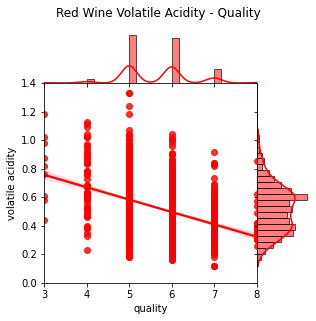

In [171]:
#Joint Plots
rj = sns.jointplot(x='quality', y='volatile acidity', data=red_wine,
kind='reg', ylim=(0, 1.4),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine Volatile Acidity - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


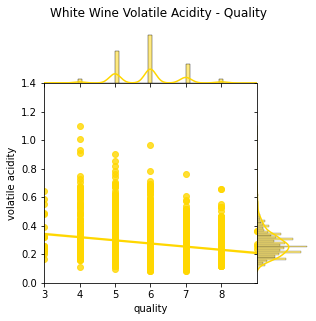

In [172]:
#Joint Plots
rj = sns.jointplot(x='quality', y='volatile acidity', data=white_wine,
kind='reg', ylim=(0, 1.4),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine Volatile Acidity - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


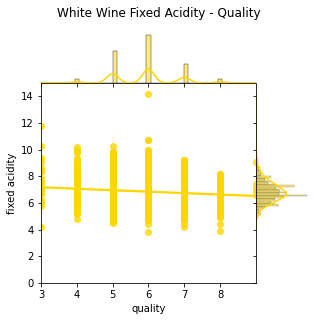

In [173]:
#Joint Plots
rj = sns.jointplot(x='quality', y='fixed acidity', data=white_wine,
kind='reg', ylim=(0, 15),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine Fixed Acidity - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


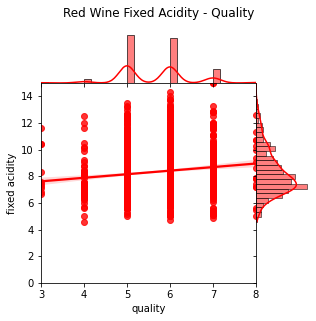

In [174]:
#Joint Plots
rj = sns.jointplot(x='quality', y='fixed acidity', data=red_wine,
kind='reg', ylim=(0, 15),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine Fixed Acidity - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


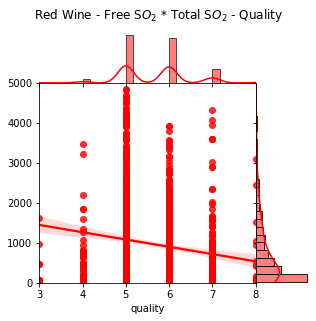

In [226]:
#Joint Plots
rj = sns.jointplot(x=red_wine['quality'], y=red_wine['free sulfur dioxide']*red_wine['total sulfur dioxide'], 
kind='reg', ylim=(0, 5000),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine - Free S' +r'$O_2$'+ ' * Total S'+r'$O_2$'+" - Quality", fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


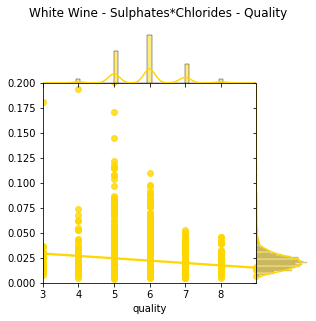

In [233]:
#Joint Plots
rj = sns.jointplot(x=white_wine['quality'], y=white_wine['sulphates']*white_wine['chlorides'], 
kind='reg', ylim=(0, 0.2),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine - Sulphates*Chlorides - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


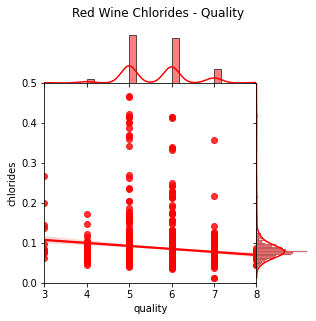

In [175]:
#Joint Plots
rj = sns.jointplot(x='quality', y='chlorides', data=red_wine,
kind='reg', ylim=(0, 0.5),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine Chlorides - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


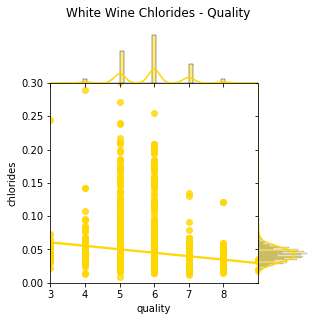

In [176]:
#Joint Plots
rj = sns.jointplot(x='quality', y='chlorides', data=white_wine,
kind='reg', ylim=(0, 0.3),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine Chlorides - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


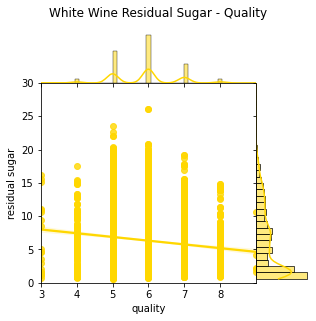

In [177]:
#Joint Plots
rj = sns.jointplot(x='quality', y='residual sugar', data=white_wine,
kind='reg', ylim=(0, 30),
color='gold', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('White Wine Residual Sugar - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:2015: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


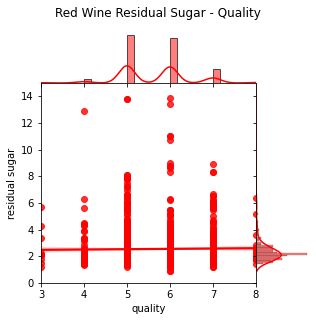

In [178]:
#Joint Plots
rj = sns.jointplot(x='quality', y='residual sugar', data=red_wine,
kind='reg', ylim=(0, 15),
color='red', space=0, size=4.5, ratio=4)
rj.ax_joint.set_xticks(list(range(3,9)))
fig = rj.fig
fig.subplots_adjust(top=0.9)
t = fig.suptitle('Red Wine Residual Sugar - Quality', fontsize=12);

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:316: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


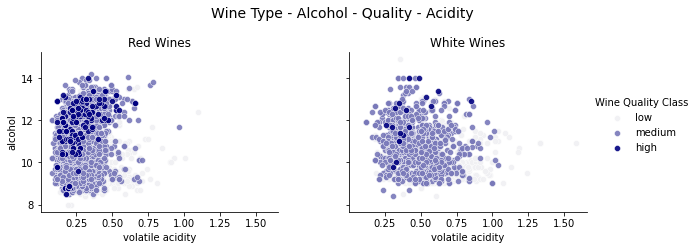

In [179]:
#Plots with color hues according to wine quality
g = sns.FacetGrid(wines, col="wine_type_code", hue='quality_label',
col_order=[1, 0], hue_order=['low', 'medium', 'high'],
aspect=1.2, size=3.5, palette=sns.light_palette('navy', 3))
g.map(plt.scatter, "volatile acidity", "alcohol", alpha=0.9,
edgecolor='white', linewidth=0.5)
axes = g.axes.flatten()
axes[0].set_title("Red Wines")
axes[1].set_title("White Wines")
fig = g.fig
fig.subplots_adjust(top=0.8, wspace=0.3)
fig.suptitle('Wine Type - Alcohol - Quality - Acidity', fontsize=14)
l = g.add_legend(title='Wine Quality Class')

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:316: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


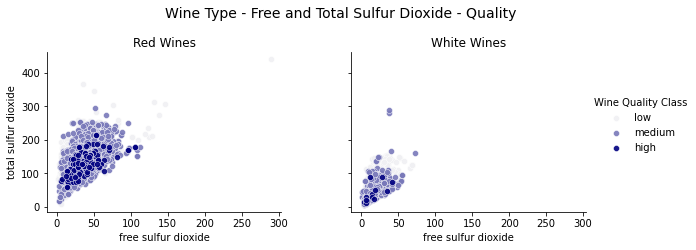

In [180]:
#Plots with color hues according to wine quality
g = sns.FacetGrid(wines, col="wine_type_code", hue='quality_label',
col_order=[1, 0], hue_order=['low', 'medium', 'high'],
aspect=1.2, size=3.5, palette=sns.light_palette('navy', 3))
g.map(plt.scatter, "free sulfur dioxide", "total sulfur dioxide", alpha=0.9, edgecolor='white', linewidth=0.5)
axes = g.axes.flatten()
axes[0].set_title("Red Wines")
axes[1].set_title("White Wines")
fig = g.fig
fig.subplots_adjust(top=0.8, wspace=0.3)
fig.suptitle('Wine Type - Free and Total Sulfur Dioxide - Quality', fontsize=14)
l = g.add_legend(title='Wine Quality Class')

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:316: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


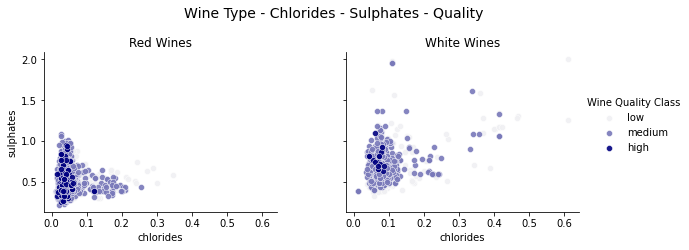

In [181]:
#Plots with color hues according to wine quality
g = sns.FacetGrid(wines, col="wine_type_code", hue='quality_label',
col_order=[1, 0], hue_order=['low', 'medium', 'high'],
aspect=1.2, size=3.5, palette=sns.light_palette('navy', 3))
g.map(plt.scatter, "chlorides", "sulphates", alpha=0.9, edgecolor='white', linewidth=0.5)
axes = g.axes.flatten()
axes[0].set_title("Red Wines")
axes[1].set_title("White Wines")
fig = g.fig
fig.subplots_adjust(top=0.8, wspace=0.3)
fig.suptitle('Wine Type - Chlorides - Sulphates - Quality', fontsize=14)
l = g.add_legend(title='Wine Quality Class')

/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:316: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


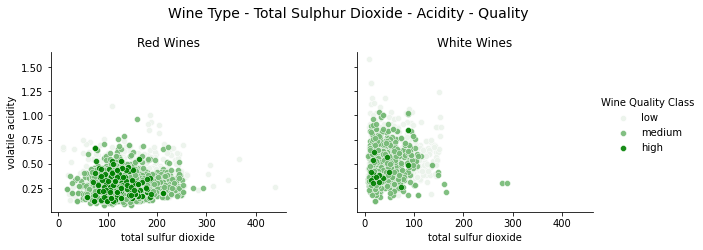

In [182]:
#Plots with color hues according to wine quality
g = sns.FacetGrid(wines, col="wine_type_code", hue='quality_label',
col_order=[1, 0], hue_order=['low', 'medium', 'high'],
aspect=1.2, size=3.5, palette=sns.light_palette('green', 3))
g.map(plt.scatter, "total sulfur dioxide", "volatile acidity", alpha=0.9, edgecolor='white', linewidth=0.5)
axes = g.axes.flatten()
axes[0].set_title("Red Wines")
axes[1].set_title("White Wines")
fig = g.fig
fig.subplots_adjust(top=0.8, wspace=0.3)
fig.suptitle('Wine Type - Total Sulphur Dioxide - Acidity - Quality', fontsize=14)
l = g.add_legend(title='Wine Quality Class')

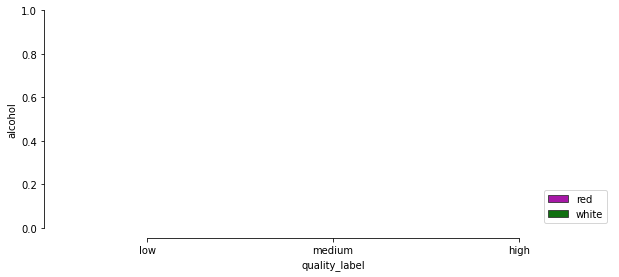

In [183]:
#Grouped Boxplots
f, ax = plt.subplots(figsize=(10, 4))
sns.boxplot(x="quality_label", y="alcohol", palette=["m", "g"], hue = 'wine_type',
            data=wines, ax = ax)

sns.despine(offset=10, trim=True)
ax.legend(loc='lower right');

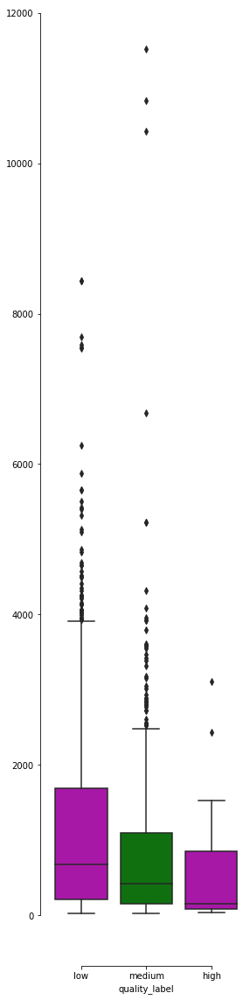

In [184]:
#Grouped Boxplots
f, ax = plt.subplots(figsize=(4,20 ))
sns.boxplot(x=red_wine["quality_label"], y=red_wine["free sulfur dioxide"]*red_wine["total sulfur dioxide"], palette=["m", "g"], ax = ax)

sns.despine(offset=10, trim=True)

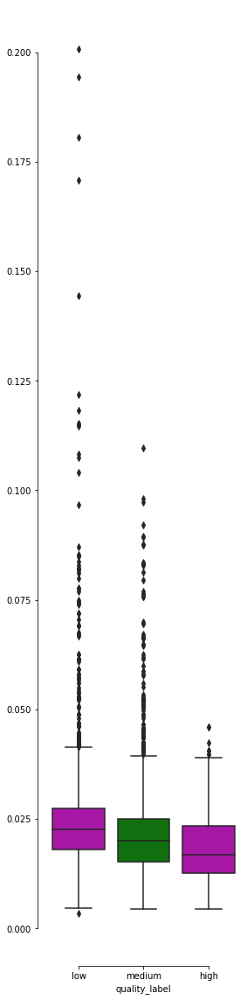

In [185]:
#Grouped Boxplots
f, ax = plt.subplots(figsize=(4,20 ))
sns.boxplot(x=white_wine["quality_label"], y=white_wine["chlorides"]*white_wine["sulphates"], palette=["m", "g"], ax = ax)

sns.despine(offset=10, trim=True)

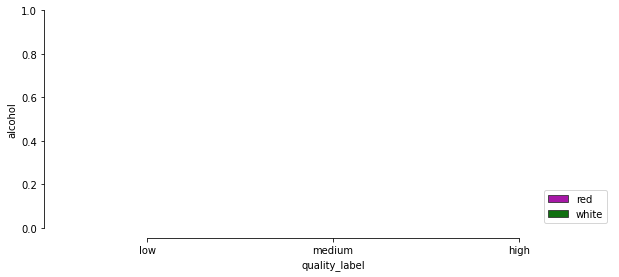

In [220]:
#Grouped Boxplots
f, ax = plt.subplots(figsize=(10, 4))
sns.boxplot(x="quality_label", y=wines["alcohol"]**2, palette=["m", "g"], hue = 'wine_type',
            data=wines, ax = ax)

sns.despine(offset=10, trim=True)
ax.legend(loc='lower right');

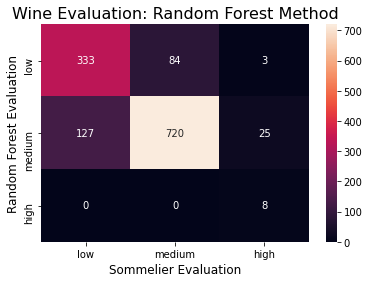

In [248]:
fig, ax = plt.subplots(1, 1)
boxplot = sns.heatmap(data=((333,84,3),(127,720,25),(0,0,8)), ax=ax, annot=True, fmt='g')
labels = ['low', 'medium', 'high']
ax.set_xticklabels(labels)
ax.set_yticklabels(labels)
ax.set_title('Wine Evaluation: Random Forest Method', fontsize=16);
ax.set_xlabel('Sommelier Evaluation', fontsize=12);
ax.set_ylabel('Random Forest Evaluation', fontsize=12);


In [188]:
np.info(sns.heatmap)

 heatmap(*args, **kwargs)

Plot rectangular data as a color-encoded matrix.

This is an Axes-level function and will draw the heatmap into the
currently-active Axes if none is provided to the ``ax`` argument.  Part of
this Axes space will be taken and used to plot a colormap, unless ``cbar``
is False or a separate Axes is provided to ``cbar_ax``.

Parameters
----------
data : rectangular dataset
    2D dataset that can be coerced into an ndarray. If a Pandas DataFrame
    is provided, the index/column information will be used to label the
    columns and rows.
vmin, vmax : floats, optional
    Values to anchor the colormap, otherwise they are inferred from the
    data and other keyword arguments.
cmap : matplotlib colormap name or object, or list of colors, optional
    The mapping from data values to color space. If not provided, the
    default will depend on whether ``center`` is set.
center : float, optional
    The value at which to center the colormap when plotting divergant dat

In [6]:
wines['est_points'] = wines['quality'].apply(lambda value: 80
if value == 3 else 83
if value == 4 else 85
if value == 5 else 89
if value == 6 else 91
if value == 7 else 92
if value == 8 else 93)

In [7]:
wines['est_price']=-100.7862+1.3153*wines['est_points']-1.7369*wines['wine_type_code']

In [8]:
wines.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,wine_type_code,wine_type,est_points,est_price
0,7.0,0.17,0.74,12.8,0.045,24.0,126.0,0.99420,3.26,0.38,12.2,8,1,white,92,18.4845
1,7.7,0.64,0.21,2.2,0.077,32.0,133.0,0.99560,3.27,0.45,9.9,5,0,red,85,11.0143
2,6.8,0.39,0.34,7.4,0.020,38.0,133.0,0.99212,3.18,0.44,12.0,7,1,white,91,17.1692
3,6.3,0.28,0.47,11.2,0.040,61.0,183.0,0.99592,3.12,0.51,9.5,6,1,white,89,14.5386
4,7.4,0.35,0.20,13.9,0.054,63.0,229.0,0.99888,3.11,0.50,8.9,6,1,white,89,14.5386
